# Set-up

In [84]:
# Import Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from numpy import loadtxt
import os, glob
import geopandas as gpd
import geojsonio
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
import math
from IPython.display import Image
from pandas_profiling import ProfileReport

# Plotly
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import cufflinks as cf

import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.subplots import make_subplots
init_notebook_mode(connected=True)
cf.go_offline()
%matplotlib inline
#pd.options.plotting.backend = "plotly"

In [85]:
# Dashboard (Global Variables)
target = "price_log"
figcount = 0
figpath = "figures_engineered/"

# Table Display Settings
pd.set_option('display.max_columns', 150)
pd.set_option('display.max_rows', 100)
pd.options.display.max_seq_items = 300
pd.set_option('display.max_colwidth', 150)

#Plotting Settings
sns.set(style="white")  #, palette=["#FF5A5F", "#00A699"])
sns.set_palette(
    sns.color_palette(
        ["#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"]))

pio.templates.default = "simple_white"
px.defaults.template = "simple_white"  # 'ggplot2', 'seaborn', 'simple_white', 'plotly', 'plotly_white', 'plotly_dark', 'presentation', 'xgridoff', 'ygridoff', 'gridon', 'none'
px.defaults.color_continuous_scale = [
    "#00A699", "#50D6B9", "#FF9A7F", "#FF5A5F"
]  # ["#50D6B9", "#00A699", "#FF9A7F", "#FF5A5F"] #"burgyl"
px.defaults.color_discrete_sequence = [
    "#767676", "#00A699", "#FF5A5F", "#F9C70C", "#FC642D", "#484848"
]
px.defaults.width = 900
px.defaults.height = 600

In [86]:
# Import data_engineered
data = pd.read_pickle("saves/data_engineered.pkl")

In [87]:
# Create path to save figures (if not existing)
if not os.path.exists(figpath):
    os.mkdir(figpath)

In [88]:
# Delete all saved plots (caution!)
del_files = glob.glob(f'{figpath}*')
for f in del_files:
    os.remove(f)

In [89]:
# Function for saving plots with continuous number
def savefig(fig=None, title="Untitled", library="py"):
    global figcount
    global figpath
    existing = False
    filesave = ""
    save_files = glob.glob(f'{figpath}*')
    for f in save_files:
        if title in f:
            existing = True
            filesave = f
    if existing == True:
        if library == "py":
            fig.write_image(filesave)
        elif library == "plt":
            plt.savefig(filesave)
        else:
            print("Please enter valid library ('py', 'plt')")
    else:
        figcount += 1
        if library == "py":
            fig.write_image(f"{figpath}fig{figcount:02d}_{title}.png")
        elif library == "plt":
            plt.savefig(f"{figpath}fig{figcount:02d}_{title}.png")
        else:
            print("Please enter valid library ('py', 'plt')")
            figcount -= 1

# Data Exploration

In [90]:
# Display available columns from "data"
data.columns

Index(['accommodates', 'accommodates_per_bed', 'am_balcony', 'am_breakfast',
       'am_child_friendly', 'am_elevator', 'am_essentials',
       'am_nature_and_views', 'am_pets_allowed', 'am_private_entrance',
       'am_smoking_allowed', 'am_tv', 'am_white_goods', 'availability_90',
       'bathrooms_log', 'bedrooms', 'calc_host_lst_count_sqrt_log',
       'cancellation_policy', 'first_review_days_sqrt', 'host_is_superhost',
       'instant_bookable', 'last_review_days_sqrt', 'latitude', 'longitude',
       'maximum_nights', 'minimum_nights_log', 'neighbourhood_cleansed',
       'number_of_reviews', 'number_of_reviews_ltm', 'occupancy_class',
       'occupancy_rate', 'price_class', 'price_extra_fees_sqrt',
       'price_extra_people', 'price_log', 'property_type',
       'review_scores_calc', 'review_scores_class', 'review_scores_class_new',
       'review_scores_rating_sqrt', 'room_type', 'text_len_sqrt',
       'wk_mth_discount', 'zipcode'],
      dtype='object')

In [91]:
# Define "reduced_features"
reduced_features = [
    "accommodates",
    "availability_365",
    #                   "availability_90",
    #                   "bathrooms",
    #                   "bedrooms",
    #                   "beds",
    "calculated_host_listings_count",
    "extra_people",
    #                   "guests_included",
    #                   "maximum_nights",
    "minimum_nights",
    "price",
    "review_scores_rating"
]

In [92]:
# Separate/create variables for numerical and categorical features
num_features = list(data.columns[data.dtypes != object])
cat_features = list(data.columns[data.dtypes == object])
#data_cont = data[num_features]

## Interactive Dashboards

In [93]:
# Display figures from graphical exploration below direcly here in the dashboard
@interact_manual
def show_images(file=sorted(os.listdir(figpath))):
    display(Image(figpath + file))

interactive(children=(Dropdown(description='file', options=(), value=None), Button(description='Run Interact',…

In [94]:
# Display table with all rows where feature value is > x (where x is the selected threshold)
@interact(x=widgets.IntSlider(1, 0, 100, 1, continuous_update=False))
def filter_data(column=num_features, x=10):
    return data.loc[data[column] > x]

interactive(children=(Dropdown(description='column', options=('accommodates', 'accommodates_per_bed', 'am_balc…

In [95]:
# Display interactive plot for comparing two features
@interact_manual(
    x=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       index=0,
                       description="Feature"),
    y=widgets.Dropdown(options=list(data.select_dtypes('number').columns),
                       value=target,
                       description="Target"),
    kind=widgets.Dropdown(
        options=["bar", "box", "bubble", "heatmap", "histogram", "scatter"],
        value="bar",
        description="Plot Type"))
#                 text='title',
#                 theme=widgets.Dropdown(options=list(cf.themes.THEMES.keys()),description="Theme"),
#                 colorscale=widgets.Dropdown(options=list(cf.colors._scales_names.keys()),description="Colorscale"))
def scatter_plot(x, y, kind):  #,theme,colorscale):

    data.iplot(kind=kind,
               x=x,
               y=y,
               mode='markers',
               xTitle=str(x),
               yTitle=str(y),
               title=f'{str(y)} vs {str(x)}')


#        text=title,
#        theme=theme,
#        colorscale=colorscale)

interactive(children=(Dropdown(description='Feature', options=('accommodates', 'accommodates_per_bed', 'am_bal…

## Tables (non-graphical exploration)

In [96]:
#profile = ProfileReport(data, title='Pandas Profiling Report', explorative=True)
#profile.to_widgets()
#profile.to_notebook_iframe()

In [97]:
# Examine shape and head/columns of data
print(data.shape)
data.head(1)

(10613, 44)


,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,cancellation_policy,first_review_days_sqrt,host_is_superhost,instant_bookable,last_review_days_sqrt,latitude,longitude,maximum_nights,minimum_nights_log,neighbourhood_cleansed,number_of_reviews,number_of_reviews_ltm,occupancy_class,occupancy_rate,price_class,price_extra_fees_sqrt,price_extra_people,price_log,property_type,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_rating_sqrt,room_type,text_len_sqrt,wk_mth_discount,zipcode
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
3176,4,2.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0,0.0,1.0,0.0,strict,62.633857,0,0,16.248077,52.535,13.41758,1125,7.874008,Prenzlauer Berg Südwest,145,1,0,0.0,3,20.0,16.666667,4.382027,Apartment,88.702175,2,1,6.298521,Entire home/apt,0.771052,0.23545,zip_10405


**Outliers**

In [98]:
# Examine illogical column values (e.g. "accommodates" < "guests_included", "bedrooms" > "beds", ...)
#data[data.accommodates-data.beds < 0]

**Skew**

In [99]:
# Look at data skew (to check whether scaling with e.g. log makes sense for highly skewed features)
data.skew()

accommodates                    1.552493
accommodates_per_bed            2.120048
am_balcony                      1.025281
am_breakfast                    4.160607
am_child_friendly               0.879322
am_elevator                     1.186676
am_essentials                  -4.661520
am_nature_and_views             4.828661
am_pets_allowed                 1.724101
am_private_entrance             1.336787
am_smoking_allowed              2.085284
am_tv                          -0.085835
am_white_goods                 -1.699179
availability_90                 0.236266
bathrooms_log                   2.590295
bedrooms                        2.197038
calc_host_lst_count_sqrt_log    1.986982
first_review_days_sqrt          0.375425
host_is_superhost               0.881780
instant_bookable                0.397982
last_review_days_sqrt           0.844525
latitude                       -0.127203
longitude                      -0.226297
maximum_nights                  1.043278
minimum_nights_l

**Correlation**

In [100]:
# Interactive feature vs. feature correlation check
@interact
def correlations(column1=list(data.select_dtypes('number').columns),
                 column2=list(data.select_dtypes('number').columns)):
    print(f"Correlation: {data[column1].corr(data[column2])}")

interactive(children=(Dropdown(description='column1', options=('accommodates', 'accommodates_per_bed', 'am_bal…

In [101]:
# Full list of correlation values
data.corr()

,accommodates,accommodates_per_bed,am_balcony,am_breakfast,am_child_friendly,am_elevator,am_essentials,am_nature_and_views,am_pets_allowed,am_private_entrance,am_smoking_allowed,am_tv,am_white_goods,availability_90,bathrooms_log,bedrooms,calc_host_lst_count_sqrt_log,first_review_days_sqrt,host_is_superhost,instant_bookable,last_review_days_sqrt,latitude,longitude,maximum_nights,minimum_nights_log,number_of_reviews,number_of_reviews_ltm,occupancy_class,occupancy_rate,price_class,price_extra_fees_sqrt,price_extra_people,price_log,review_scores_calc,review_scores_class,review_scores_class_new,review_scores_rating_sqrt,text_len_sqrt,wk_mth_discount
accommodates,1.000000,0.198126,0.070049,-0.022180,0.317107,0.060143,-0.041852,0.003273,0.081136,0.157469,-0.102220,0.269700,0.038954,0.099644,0.244023,0.667731,0.285817,0.080549,-0.015834,0.095161,-0.048879,0.037161,0.010964,0.118434,-0.061980,0.111148,0.112237,0.098246,0.106288,0.473639,0.210922,0.322917,0.483497,-0.079851,-0.133104,-0.112543,-0.120027,0.167517,0.000266
accommodates_per_bed,0.198126,1.000000,0.036693,0.008657,0.047373,0.060848,-0.066256,-0.004373,0.028361,0.007147,0.010901,0.038256,0.048380,-0.030602,-0.020161,-0.073641,-0.005302,0.007419,0.003087,0.027213,-0.035691,0.009248,0.031718,0.035374,-0.041223,0.034211,0.025392,0.012908,0.017943,0.137596,0.027866,0.167122,0.136067,0.017765,-0.001473,0.012000,0.001371,0.034065,-0.002916
am_balcony,0.070049,0.036693,1.000000,-0.010255,0.097019,0.155736,0.072958,0.104178,0.009563,0.039115,0.011232,0.105188,0.145473,-0.034649,0.093495,0.097438,-0.101834,0.048667,0.118520,-0.016589,-0.012008,0.010816,0.005922,-0.021708,0.004690,-0.010739,-0.007394,-0.009568,-0.010722,0.133134,0.114065,0.065776,0.135193,0.119932,0.101895,0.129903,0.101190,0.126853,0.025299
am_breakfast,-0.022180,0.008657,-0.010255,1.000000,-0.029991,0.003720,0.029185,0.004666,0.035661,0.001650,0.034022,-0.027192,-0.002993,0.008293,-0.012585,-0.017628,-0.047680,-0.081387,-0.023115,0.023171,0.034835,-0.006565,-0.012762,-0.011319,-0.046212,-0.064683,-0.069833,-0.057656,-0.062184,0.008795,-0.038541,0.007833,0.018312,0.010459,0.055255,0.035252,0.048805,-0.014130,-0.032570
am_child_friendly,0.317107,0.047373,0.097019,-0.029991,1.000000,0.032772,-0.009942,0.013222,0.069376,0.020533,-0.081066,0.167523,0.035127,0.055815,0.090188,0.262300,0.112561,0.453878,0.060763,0.008770,0.022064,0.005492,0.016864,0.023552,0.032674,0.277202,0.122107,0.044429,0.053224,0.204458,0.158878,0.175578,0.206778,-0.023939,-0.106779,-0.085657,-0.101611,0.193665,0.172248
am_elevator,0.060143,0.060848,0.155736,0.003720,0.032772,1.000000,-0.013000,0.033281,-0.019141,0.000819,-0.018169,0.150358,0.061632,0.051332,0.108313,0.032013,0.112000,0.005864,0.032415,0.016122,0.026304,0.046319,-0.041917,0.031787,0.041725,-0.000420,0.016781,0.012010,0.018132,0.200284,0.079344,0.029086,0.206421,-0.010342,-0.007825,-0.006671,-0.006993,0.026592,-0.009367
am_essentials,-0.041852,-0.066256,0.072958,0.029185,-0.009942,-0.013000,1.000000,0.020900,0.017200,0.055797,0.016351,-0.017012,0.052914,-0.013697,-0.013843,-0.000790,-0.148686,-0.068924,0.095339,0.024407,-0.048203,-0.006438,0.009932,0.012245,-0.028951,0.030487,0.056134,0.034312,0.042358,0.011459,0.028715,-0.036050,0.016389,0.081817,0.081586,0.101864,0.073683,0.037748,-0.059286
am_nature_and_views,0.003273,-0.004373,0.104178,0.004666,0.013222,0.033281,0.020900,1.000000,0.028449,0.051216,-0.007432,0.041735,0.002872,0.026062,0.018706,0.006014,-0.012454,-0.007074,0.042492,-0.001589,0.004584,-0.047573,0.003883,0.008318,-0.020078,-0.011264,0.007574,0.004242,-0.004810,0.000085,0.019607,0.017716,-0.001758,0.016846,0.009347,0.013497,0.006158,0.026769,-0.009449
am_pets_allowed,0.081136,0.028361,0.009563,0.035661,0.069376,-0.019141,0.017200,0.028449,1.000000,0.011816,0.140631,0.017688,0.011577,0.037738,0.023286,0.035124,0.011979,0.025146,-0.004075,0.045011,0.002360,-0.039994,0.022008,0.020585,-0.047343,0.027476,0.018044,-0.008130,-0.002879,0.007526,-0.042196,0.030544,0.009390,-0.

## Plot visualizations (graphical exploration)

In [102]:
# Histogram of price_log
fig = px.histogram(
    data,
    x="price_log",
    title="Price Histogram",
    #             color="host_is_superhost",
    marginal="rug",  # 'rug', 'box', 'violin', 'histogram'
    nbins=50)

fig.show()
savefig(fig, title="histogram_price_log")

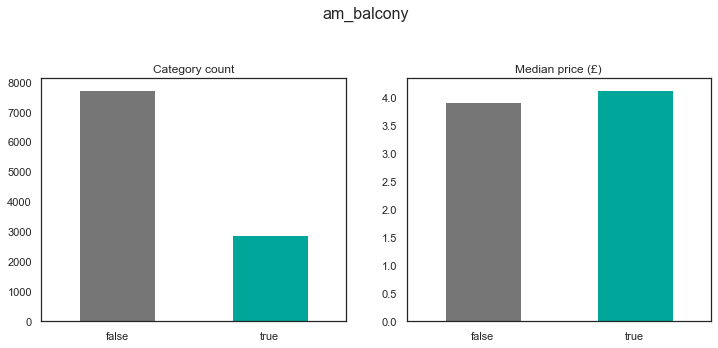

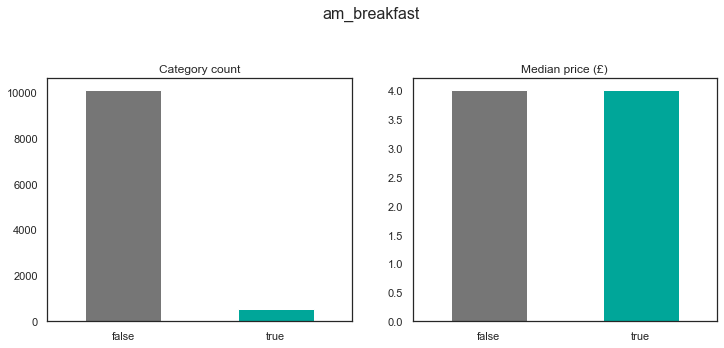

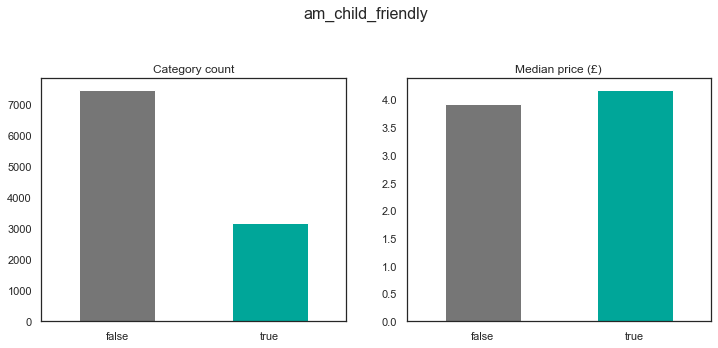

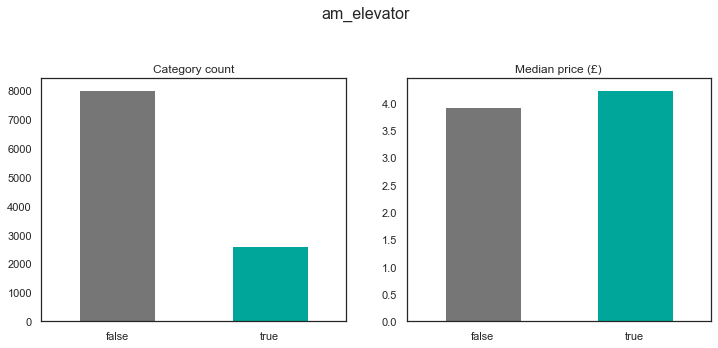

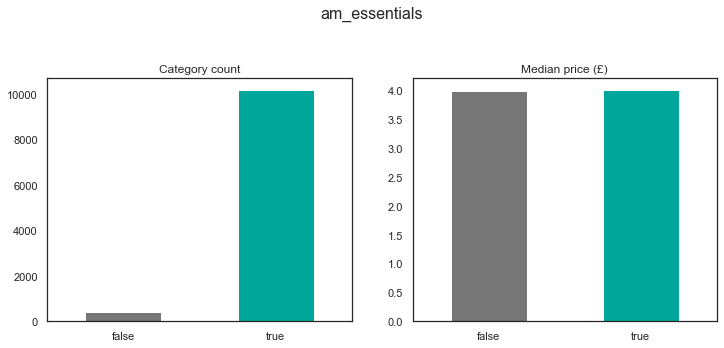

...

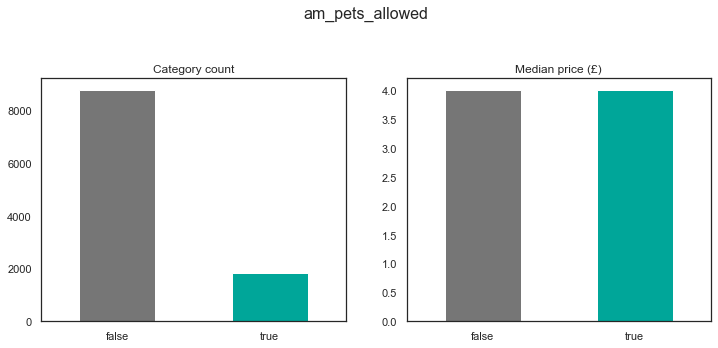

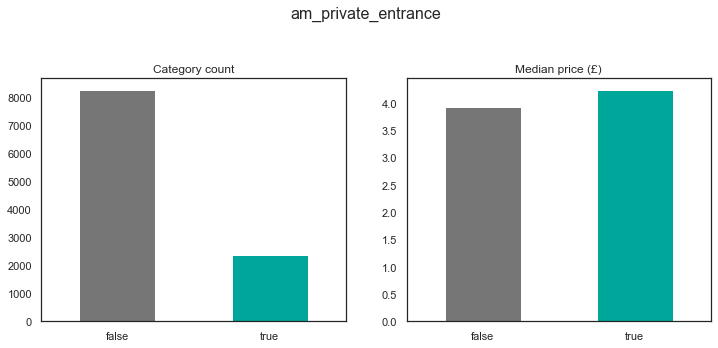

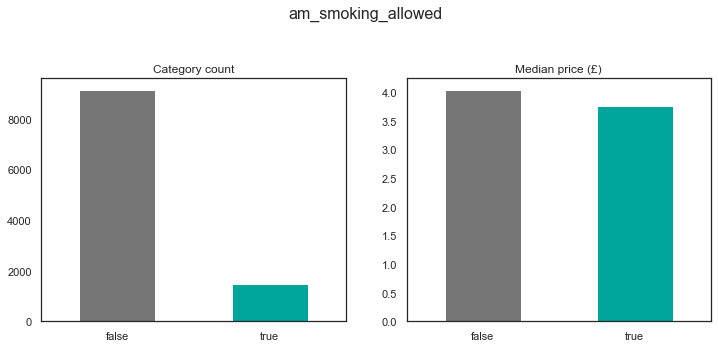

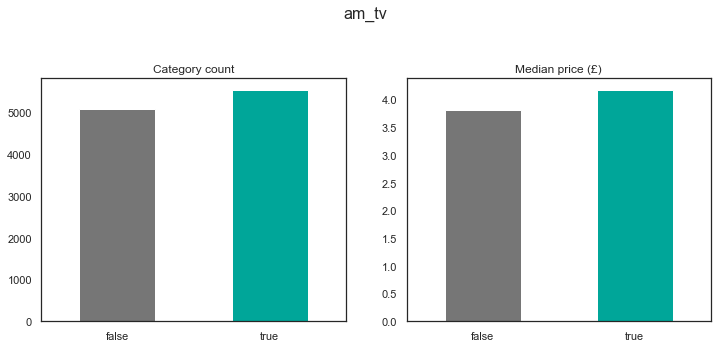

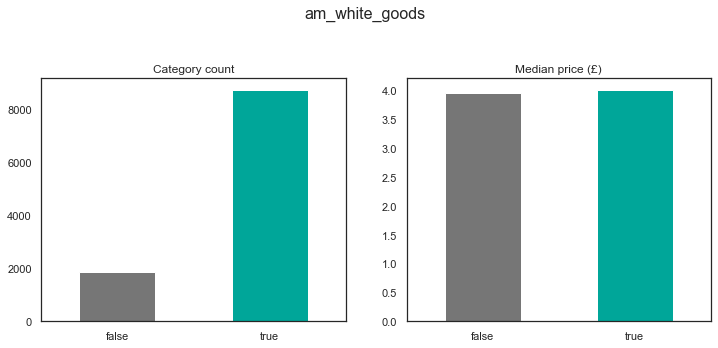

In [103]:
# Count and median price for amenities
am_col = [el for el in data.columns if el.startswith("am_")]

for col in am_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (£)')
    ax2.set_xlabel('')

    plt.show()

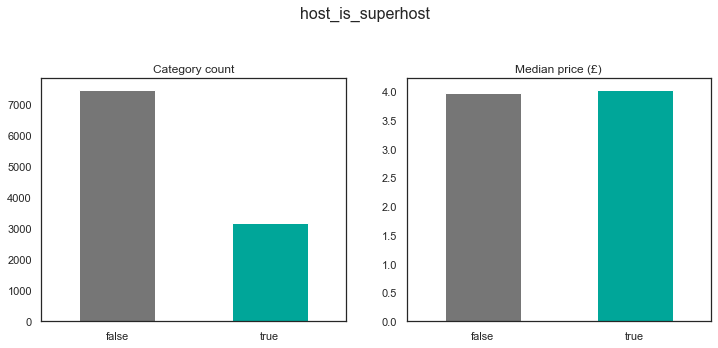

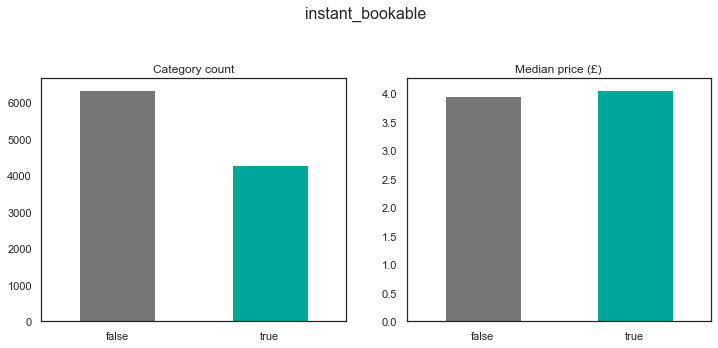

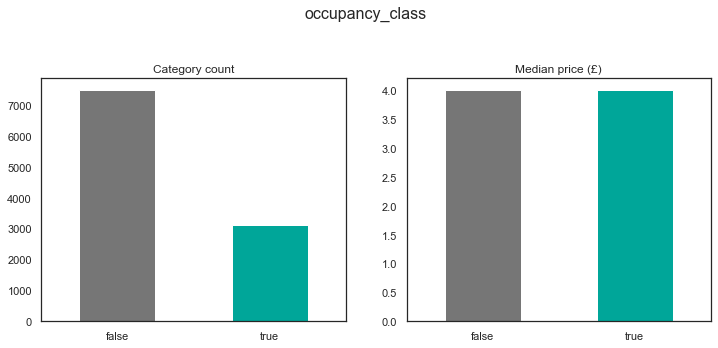

In [104]:
# Count and median price for binary columns
bin_col = ["host_is_superhost", "instant_bookable", "occupancy_class"]

for col in bin_col:
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(
        top=0.80
    )  # So that the suptitle does not overlap with the ax plot titles

    data.groupby(col).size().plot(kind='bar',
                                  ax=ax1,
                                  color=["#767676", "#00A699"])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')

    data.groupby(col).price_log.median().plot(kind='bar',
                                              ax=ax2,
                                              color=["#767676", "#00A699"])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (£)')
    ax2.set_xlabel('')

    plt.show()

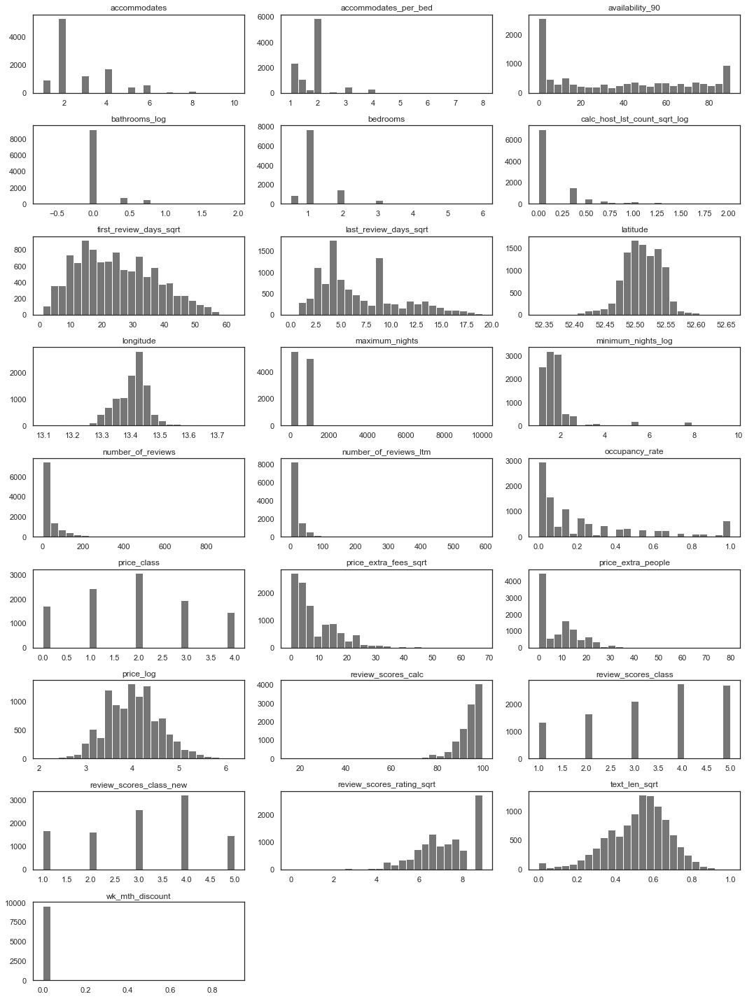

In [105]:
# Histogram of numerical features except amenities
hist_col = [el for el in num_features if el not in am_col]
hist_col = [el for el in hist_col if el not in bin_col]

data[hist_col].hist(figsize=(15, 20),
                    bins=25,
                    layout=(int(len(hist_col) / 3) + 1, 3),
                    grid=False)
plt.tight_layout()
savefig(title="histogram_num_features", library="plt")

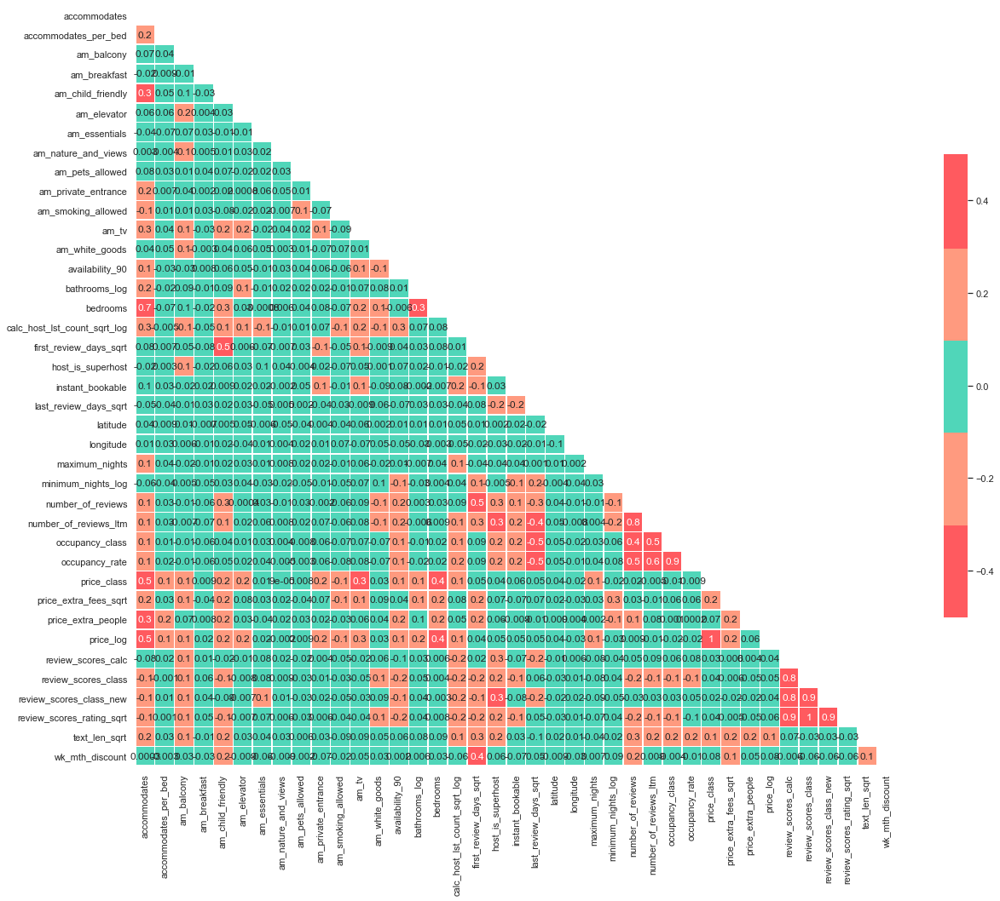

In [106]:
# Correlation heatmap for numerical features (Version 1)
#Generate a mask for the upper triangle
mask = np.triu(np.ones_like(data[num_features].corr(), dtype=np.bool))

#Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

#Generate a custom diverging colormap
#cmap = sns.diverging_palette(220, 10, as_cmap=True)
#cmap = [(0, 166, 153), (255, 90, 95)]

#Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(data[num_features].corr(),
            mask=mask,
            cmap=["#FF5A5F", "#FF9A7F", "#50D6B9", "#FF9A7F", "#FF5A5F"],
            vmax=.5,
            vmin=-.5,
            center=0,
            square=True,
            linewidths=.5,
            cbar_kws={"shrink": .5},
            annot=True,
            fmt=".1g")

savefig(title="full_heatmap", library="plt")

In [107]:
# Correlation heatmap for numerical features (Version 2)
corr = data[num_features].corr().copy()
N = len(num_features)
#hovertext = [[f'corr({num_features[i]}, {num_features[j]})= {corr[i][j]:.2f}' if i>j else '' for j in range(N)] for i in range(N)]

heatmp = go.Heatmap(
    z=corr,
    x=num_features,
    y=num_features,
    xgap=1,
    ygap=1,
    text=corr,
    colorbar_thickness=20,
    colorbar_ticklen=3,
            colorscale=[
            [0, "#B6B6B6"],
            [0.5, "#50D6B9"],
            [1.0, "#00A699"]
        ]
)

#data = [trace]
layout = go.Layout(title_text="Correlation Heatmap Numerical Features",
                   title_x=0.5,
                   xaxis_showgrid=False,
                   yaxis_showgrid=False,
                   yaxis_autorange='reversed',
                   width=900,
                   height=900)
fig = go.Figure(data=heatmp, layout=layout)

fig.show()
#savefig(fig, title="scatter_price_vs_accommodates")

Highly correlated features will be removed from the analysis. For this purpose, the threshold is set at two correlations of 0.4 or above. Hence, the following features are removed:

| **FEATURE** | **REASONING** |
| :----- | :----- |
| **** |  |
| **** |  |



In [108]:
# Scatterplot y=price_log x=calculated_host_listings_count
data.host_is_superhost = data.host_is_superhost.astype(str)
fig = px.scatter(data,
                 x='accommodates',
                 y='price_log',
                 title='Price vs. Accommodates',
                 color='host_is_superhost',
                 color_continuous_scale=None,
                 marginal_y='violin',
                 marginal_x='box',
                 trendline='ols',
                 opacity=0.3)
fig.show()
savefig(fig, title="scatter_price_vs_accommodates")
data.host_is_superhost = data.host_is_superhost.astype(int)

In [109]:
# Histogram matrix price class vs. room type vs. occupancy
fig = px.histogram(
    data,
    x='price_class',
    title='Price Class by Room Type',
    color='host_is_superhost',
    barmode='relative',  # 'group', 'overlay', 'relative'
    facet_row='occupancy_class',
    facet_col='room_type',
)
fig.show()
savefig(fig, title="facet_price_vs_room_type")

In [110]:
# Scatter Matrix of select features
fig = px.scatter_matrix(data,
                        dimensions=[
                            "accommodates", "calc_host_lst_count_sqrt_log",
                            "price_log", "review_scores_rating_sqrt"
                        ],
                        title="Scatter Matrix",
                        color='room_type',
                        opacity=0.5,
                        width=1000,
                        height=1000)
fig.show()
savefig(fig, title="matrix_key_features")

In [111]:
# Parallel Categories for select features
fig = px.parallel_categories(data,
                             title="Parallel Categories",
                             dimensions=[
                                 "room_type", "price_class",
                                 "review_scores_class", "occupancy_class"
                             ],
                             color='host_is_superhost')

fig.show()
savefig(fig, title="parcat_occupancy_class")

In [112]:
# Plot histogram of review_scores_class
fig = px.histogram(
    data,
    x="review_scores_class",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores")

Class "5" for review scores equals a perfect score of 100%. Consequently, the plot indicates:
- Unsurprisingly, the amount of superhosts correlates with review scores, at least up until class "5"
- The lower amount of superhosts among class "5" indicates that these listings may have received less reviews so far, hence achieving 100% with few ratings (to be verified in sequence)

In [113]:
# Boxplot review_scores_class vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_review_scores_vs_first_review_days")

This plot seems to confirm that listings with perfect scores tend to be newer - particularly those which are not listed by a superhost. This should be considered for predictive modeling as it might distort the results. Hence, a new feature is created, penalizing a) new listings and b) listings with few reviews in the last twelve months (see below)

In [114]:
# Plot histogram of review_scores_class_new
fig = px.histogram(
    data,
    x="review_scores_class_new",
    color="host_is_superhost",
    title="Review Scores Histogram",
    #             marginal="rug",
    nbins=50)

fig.show()
savefig(fig, title="histogram_review_scores")

In [115]:
# Boxplot review_scores_class_new vs. first_review_days_sqrt
fig = px.box(data,
             x="review_scores_class_new",
             y="first_review_days_sqrt",
             title='Review Scores vs. Days since First Review',
             color="host_is_superhost",
             points="outliers")
fig.show()
#savefig(fig, title="box_review_scores_vs_first_review_days")

The impact is clearly visible when measuring the share of superhosts. However, the impact on price is marginal at best (see below) and - even when adapting the penalization - unfortunately did not yield any improvements to the predictive models.

In [116]:
# Stripplot price_log vs review_scores_class
fig = px.strip(data,
               x="price_log",
               y="review_scores_class",
               title="Price vs. Review Scores Class",
               orientation="h",
               color="occupancy_class")
fig.show()
#savefig(fig, title="strip_price_vs_roomtype")

In [117]:
# Stripplot price_log vs review_scores_class_new
fig = px.strip(data,
               x="price_log",
               y="review_scores_class_new",
               title="Price vs. Review Scores Class New",
               orientation="h",
               color="occupancy_class")
fig.show()
#savefig(fig, title="strip_price_vs_roomtype")

In [30]:
# Boxplot price_log vs. accommodates
fig = px.box(data,
             y="price_log",
             x="accommodates",
             title="Price vs. Accommodates",
             color="host_is_superhost",
             points="outliers")
fig.show()
savefig(fig, title="box_price_vs_accommodates")

In [31]:
# Violinplot price_log vs. accommodates
fig = px.violin(data,
                y="price_log",
                x="accommodates",
                title="Price vs. Accommodates",
                color="host_is_superhost",
                box=True,
                points="all")
fig.show()
savefig(fig, title="violin_price_vs_accommodates")

In [32]:
# Violinplot price_log vs. calc_host_lst_count_sqrt_log
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Price vs. Host Listings",
    color="host_is_superhost",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_host_listings")

In [33]:
# Violinplot price_log vs. cancellation_policy
fig = px.violin(
    data,
    y="price_log",
    x="cancellation_policy",
    title="Price vs. Cancellation Policy",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_cancellation_policy")

In [34]:
# Violinplot price_log vs. wk_mth_discount
fig = px.violin(
    data,
    y="wk_mth_discount",
    x="price_class",
    title="Price vs. Discount",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_price_vs_discount")

In [35]:
# Violinplot price_log vs. text_len_sqrt
fig = px.violin(
    data,
    y="calc_host_lst_count_sqrt_log",
    x="price_class",
    title="Host Listings vs. Price Class",
    color="occupancy_class",
    #                points="all",
    box=True)
fig.show()
savefig(fig, title="violin_host_listings_vs_price_class")

In [36]:
# Stripplot price_log vs room_type
fig = px.strip(data,
               x="price_log",
               y="room_type",
               title="Price vs. Room Type",
               orientation="h",
               color="occupancy_class")
fig.show()
savefig(fig, title="strip_price_vs_roomtype")

## Map visualizations (graphical exploration)

In [37]:
# Prepare geojson and data_geo

# Load up the file
geojson = gpd.read_file('data/2019-12-11/neighbourhoods.geojson')

# Creating a dataframe of listing counts and median price by borough
data_geo = pd.DataFrame(data.groupby('neighbourhood_cleansed').size())
data_geo.rename(columns={0: 'number_of_listings'}, inplace=True)
data_geo['median_price_log'] = data.groupby(
    'neighbourhood_cleansed').price_log.median().values

# Calculate price
data["price"] = [round(math.exp(el)) for el in data.price_log]
data_geo['median_price'] = data.groupby(
    'neighbourhood_cleansed').price.median().values

# Joining the dataframes
#data_geo_map = geojson.set_index('neighbourhood').join(data_geo)
data_geo["neighbourhood"] = data_geo.index

In [38]:
# Berlin map with all listings (color = price; size = accommodates)
fig = px.scatter_mapbox(
    data,
    title="Berlin | All Listings",
    lat="latitude",
    lon="longitude",
    color="price_log",
    size="accommodates",
    size_max=15,
    hover_name="room_type",
    hover_data={
        "latitude": False,
        "longitude": False,
        "price_log": False,
        "bedrooms": True,
        "price": True,
        "neighbourhood_cleansed": False,
        "occupancy_rate": True,
        "occupancy_rate": ":.2f"
    },
    #    range_color=[10,200],
    zoom=9,
    opacity=0.8,
    mapbox_style="carto-positron")

fig.show()
savefig(fig, title="Berlin_map_all_listings")

In [39]:
# Berlin map with listings per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title="Berlin | Listings per Neighbourhood",
                           geojson=geojson,
                           color="number_of_listings",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": 52.5200,
                               "lon": 13.4050
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price_log": True,
                               "median_price_log": ":.2f",
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title="Berlin_map_listings_per_neighbh")

In [40]:
# Berlin map with prices per "neighbourhood_cleansed"
fig = px.choropleth_mapbox(data_geo,
                           title="Berlin | Avg Prices per Neighbourhood",
                           geojson=geojson,
                           color="median_price_log",
                           locations="neighbourhood",
                           featureidkey="properties.neighbourhood",
                           center={
                               "lat": 52.5200,
                               "lon": 13.4050
                           },
                           hover_name="neighbourhood",
                           hover_data={
                               "number_of_listings": True,
                               "median_price": ":.2f",
                               "median_price_log": False,
                               "neighbourhood": False
                           },
                           mapbox_style="carto-positron",
                           zoom=9,
                           opacity=0.5)
fig.show()
savefig(fig, title="Berlin_map_price_per_neighbh")